<a href="https://colab.research.google.com/github/brainmentorspvtltd/IGDTU_ImageProcessingTF/blob/main/IG_FoodClassificationResNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os

os.environ["KAGGLE_USERNAME"] = "ravikanttyagi"
os.environ["KAGGLE_KEY"] = "095a21c789eb4728fde2b29230033273"

!kaggle datasets download utkarshsaxenadn/fast-food-classification-dataset

100% 819M/821M [00:48<00:00, 22.3MB/s]
100% 821M/821M [00:48<00:00, 17.9MB/s]


In [2]:
from IPython.display import clear_output

!unzip fast-food-classification-dataset.zip

clear_output()

In [3]:
%load_ext tensorboard

In [15]:
import cv2
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, MaxPool2D, Dense, Flatten, Dropout
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [5]:
train_dir = "Fast Food Classification V2/Train"
test_dir = "Fast Food Classification V2/Test"
val_dir = "Fast Food Classification V2/Valid"

In [9]:
image_data_gen = ImageDataGenerator(rescale=1/255.,
                                    horizontal_flip=True)

X_train = image_data_gen.flow_from_directory(train_dir, target_size=(224,224),
                                             batch_size=32, class_mode="sparse")

X_val = image_data_gen.flow_from_directory(val_dir, target_size=(224,224),
                                             batch_size=32, class_mode="sparse")

X_test = image_data_gen.flow_from_directory(test_dir, target_size=(224,224),
                                             batch_size=32, class_mode="sparse")

Found 15000 images belonging to 10 classes.
Found 3500 images belonging to 10 classes.
Found 1500 images belonging to 10 classes.


In [10]:
from tensorflow.keras.applications import InceptionV3, VGG19, ResNet101

In [11]:
resnet = ResNet101()

In [12]:
resnet.summary()

Model: "resnet101"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                          

In [13]:
resnet.output

<KerasTensor: shape=(None, 1000) dtype=float32 (created by layer 'predictions')>

In [14]:
x = resnet.output
# Adding hidden layer
x = Dense(1024, activation="relu")(x)
# Add output layer
output = Dense(10, activation="softmax")(x)

In [16]:
model = Model(inputs=resnet.input, outputs=output)

In [17]:
from tensorflow.python.ops import histogram_ops
from datetime import datetime as dt
def train_model():
  model.compile(optimizer="adam",
                loss="sparse_categorical_crossentropy",
                metrics=["accuracy"])

  logdir = os.path.join("logs", dt.now().strftime("%Y%m%d-%H%M%S"))
  tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
  model.fit(X_train, validation_data=X_val, epochs=10, callbacks=[tensorboard_callback])

In [18]:
train_model()

Epoch 1/10
 68/469 [===>..........................] - ETA: 3:58 - loss: 2.2992 - accuracy: 0.1176

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


469/469 [==============================] - 410s 676ms/step - loss: 2.2883 - accuracy: 0.1205 - val_loss: 2.2994 - val_accuracy: 0.1503
Epoch 2/10
469/469 [==============================] - 311s 663ms/step - loss: 2.1403 - accuracy: 0.2013 - val_loss: 2.6737 - val_accuracy: 0.0757
Epoch 3/10
469/469 [==============================] - 311s 664ms/step - loss: 2.0250 - accuracy: 0.2474 - val_loss: 2.2638 - val_accuracy: 0.1826
Epoch 4/10
469/469 [==============================] - 310s 660ms/step - loss: 1.9866 - accuracy: 0.2769 - val_loss: 2.0320 - val_accuracy: 0.2397
Epoch 5/10
469/469 [==============================] - 310s 660ms/step - loss: 1.9971 - accuracy: 0.2691 - val_loss: 2.1337 - val_accuracy: 0.2309
Epoch 6/10
469/469 [==============================] - 309s 658ms/step - loss: 1.9024 - accuracy: 0.3071 - val_loss: 2.6394 - val_accuracy: 0.2057
Epoch 7/10
469/469 [==============================] - 307s 655ms/step - loss: 1.7891 - accuracy: 0.3651 - val_loss: 1.8996 - val_accura

In [19]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [20]:
from tensorboard import notebook

In [21]:
notebook.list()

Known TensorBoard instances:
  - port 6006: logdir logs (started 0:01:48 ago; pid 17710)


In [22]:
notebook.display(port=6006, height=500)

Selecting TensorBoard with logdir logs (started 0:02:03 ago; port 6006, pid 17710).


<IPython.core.display.Javascript object>

In [23]:
model.evaluate(X_test)

47/47 [==============================] - 11s 222ms/step - loss: 1.3942 - accuracy: 0.5347


[1.3942420482635498, 0.5346666574478149]

In [24]:
y_pred = model.predict(X_test)

47/47 [==============================] - 12s 198ms/step


In [25]:
y_pred[0]

array([0.02840891, 0.04262014, 0.01333007, 0.06969874, 0.08830219,
       0.42761073, 0.07648295, 0.06036555, 0.13128434, 0.06189635],
      dtype=float32)

In [26]:
y_pred = np.argmax(y_pred, axis=1)

In [27]:
y_pred[:5]

array([5, 6, 9, 2, 5])

In [28]:
y_test = []
for i in range(int(X_test.n/32) + 1):
  img, labels = next(X_test)
  for label in labels:
    y_test.append(label)

In [29]:
y_test[:5]

[7.0, 5.0, 5.0, 1.0, 5.0]

In [31]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

In [32]:
cm = confusion_matrix(y_pred, y_test)

In [33]:
cm

array([[ 2,  8,  5, 10,  4,  8,  8, 13,  4,  2],
       [11, 15, 11, 16,  3, 15, 30, 17, 12,  9],
       [11, 17,  7, 20,  7, 19, 11, 11, 11,  4],
       [18, 41, 24, 39, 22, 33, 41, 34, 25, 23],
       [ 7, 17, 10, 24, 10, 20, 23, 35, 10, 19],
       [23, 46, 20, 46, 21, 46, 43, 41, 12, 21],
       [11, 31,  9, 23, 20, 27, 21, 26, 15, 12],
       [ 9, 11,  5,  7,  4,  5, 10,  9,  4,  4],
       [ 7,  8,  4, 12,  8, 15, 11,  9,  3,  4],
       [ 1,  6,  5,  3,  1, 12,  2,  5,  4,  2]])

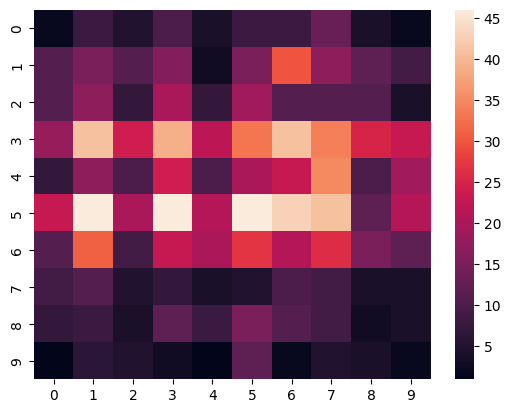

In [34]:
sns.heatmap(cm)
plt.show()

In [36]:
from tensorflow.keras.utils import plot_model

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.988357 to fit



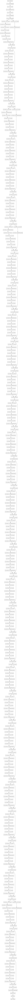

In [37]:
plot_model(model)